# Object Detection API Demo

<table align="left"><td>
  <a target="_blank"  href="https://colab.sandbox.google.com/github/tensorflow/models/blob/master/research/object_detection/colab_tutorials/object_detection_tutorial.ipynb">
    <img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab
  </a>
</td><td>
  <a target="_blank"  href="https://github.com/tensorflow/models/blob/master/research/object_detection/colab_tutorials/object_detection_tutorial.ipynb">
    <img width=32px src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View source on GitHub</a>
</td></table>

Welcome to the [Object Detection API](https://github.com/tensorflow/models/tree/master/research/object_detection). This notebook will walk you step by step through the process of using a pre-trained model to detect objects in an image.

> **Important**: This tutorial is to help you through the first step towards using [Object Detection API](https://github.com/tensorflow/models/tree/master/research/object_detection) to build models. If you just just need an off the shelf model that does the job, see the [TFHub object detection example](https://colab.sandbox.google.com/github/tensorflow/hub/blob/master/examples/colab/object_detection.ipynb).

# Setup

Important: If you're running on a local machine, be sure to follow the [installation instructions](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/installation.md). This notebook includes only what's necessary to run in Colab.

### Install

In [19]:
!pip install -U --pre tensorflow=="2.*"
!pip install tf_slim

Make sure you have `pycocotools` installed

In [20]:
!pip install pycocotools

Get `tensorflow/models` or `cd` to parent directory of the repository.

In [21]:
import os
import pathlib


if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

Compile protobufs and install the object_detection package

In [22]:
%%bash
cd ../models/research/
protoc object_detection/protos/*.proto --python_out=.

In [23]:
%%bash 
cd ../models/research
pip install .

Processing /tf/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1616285 sha256=5bc0453d1ce0b974851880dbd46c95d2169a954e2b231dfb8667550b977debfb
  Stored in directory: /tmp/pip-ephem-wheel-cache-t35lx0__/wheels/1b/00/50/d3675d90b11a88efdd99ed80b60a2b19e5769a0bb333440375
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


### Imports

In [24]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

Import the object detection module.

In [25]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

Patches:

In [26]:
# patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

# Model preparation 

## Variables

Any model exported using the `export_inference_graph.py` tool can be loaded here simply by changing the path.

By default we use an "SSD with Mobilenet" model here. See the [detection model zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md) for a list of other models that can be run out-of-the-box with varying speeds and accuracies.

## Loader

In [27]:
def load_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(
    fname=model_name, 
    origin=base_url + model_file,
    untar=True)

  model_dir = pathlib.Path(model_dir)/"saved_model"

  model = tf.saved_model.load(str(model_dir))

  return model

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [28]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = '../models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

For the sake of simplicity we will test on 2 images:

In [29]:
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('../test-images/images/')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[PosixPath('../test-images/images/custom-huskies.jpg'),
 PosixPath('../test-images/images/custom_cars.jpg'),
 PosixPath('../test-images/images/custom_giraffe.jpg'),
 PosixPath('../test-images/images/custom_gordon-setter.jpg'),
 PosixPath('../test-images/images/custom_horse.jpg'),
 PosixPath('../test-images/images/dog.jpg'),
 PosixPath('../test-images/images/eagle.jpg'),
 PosixPath('../test-images/images/giraffe.jpg'),
 PosixPath('../test-images/images/horses.jpg'),
 PosixPath('../test-images/images/kite.jpg'),
 PosixPath('../test-images/images/person.jpg'),
 PosixPath('../test-images/images/plain.jpg'),
 PosixPath('../test-images/images/scream.jpg')]

# Detection

Load an object detection model:

In [30]:
model_name = 'ssd_mobilenet_v1_coco_2017_11_17'
detection_model = load_model(model_name)

76537856/76534733 [==============================] - 24s 0us/step
INFO:tensorflow:Saver not created because there are no variables in the graph to restore


Check the model's input signature, it expects a batch of 3-color images of type uint8:

In [31]:
print(detection_model.signatures['serving_default'].inputs)

[<tf.Tensor 'image_tensor:0' shape=(None, None, None, 3) dtype=uint8>]


And returns several outputs:

In [32]:
detection_model.signatures['serving_default'].output_dtypes

{'num_detections': tf.float32,
 'detection_scores': tf.float32,
 'detection_boxes': tf.float32,
 'detection_classes': tf.float32}

In [33]:
detection_model.signatures['serving_default'].output_shapes

{'num_detections': TensorShape([None]),
 'detection_scores': TensorShape([None, 100]),
 'detection_boxes': TensorShape([None, 100, 4]),
 'detection_classes': TensorShape([None, 100])}

Add a wrapper function to call the model, and cleanup the outputs:

In [34]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
        tf.convert_to_tensor(output_dict['detection_masks']), output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

Run it on each test image and show the results:

In [58]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  print(      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))
  return output_dict

[[[196 209 226]
  [196 209 226]
  [196 209 226]
  ...
  [187 205 225]
  [188 206 226]
  [188 206 226]]

 [[196 209 226]
  [196 209 226]
  [196 209 226]
  ...
  [187 205 225]
  [189 207 227]
  [189 207 227]]

 [[195 208 225]
  [195 208 225]
  [195 208 225]
  ...
  [189 206 226]
  [191 208 228]
  [191 208 228]]

 ...

 [[198 209 231]
  [198 209 231]
  [198 209 231]
  ...
  [215 222 232]
  [215 222 232]
  [215 222 232]]

 [[197 208 230]
  [197 208 230]
  [197 208 230]
  ...
  [215 222 232]
  [215 222 232]
  [215 222 232]]

 [[197 208 230]
  [197 208 230]
  [197 208 230]
  ...
  [215 222 232]
  [215 222 232]
  [215 222 232]]] [[2.13708997e-01 1.88369751e-02 9.14849520e-01 4.81381655e-01]
 [1.82806373e-01 4.56193984e-01 9.18347597e-01 9.13761318e-01]
 [2.13576138e-01 1.44720674e-02 9.05228674e-01 4.72947687e-01]
 [2.39299566e-01 4.46475089e-01 9.24179196e-01 8.94239604e-01]
 [1.82806373e-01 4.56193984e-01 9.18347597e-01 9.13761318e-01]
 [4.76239696e-02 4.87019062e-01 1.25673383e-01 6.112798

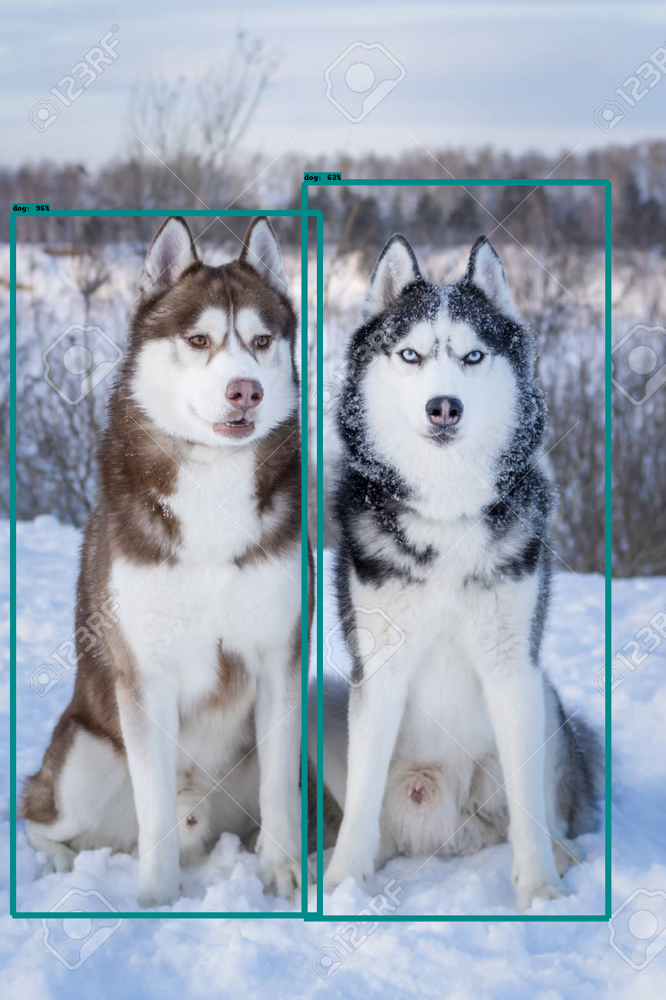

{'detection_scores': array([0.95788777, 0.6274937 , 0.16355878, 0.14694214, 0.107921  ,
       0.10687092, 0.09858951, 0.09295014, 0.07972619, 0.07513329,
       0.07142982, 0.06341204, 0.06220457, 0.06150573, 0.0592384 ,
       0.05881944, 0.05713317, 0.05617848, 0.0559454 , 0.05468693,
       0.0544408 , 0.05322993, 0.05298489, 0.05240679, 0.05117828,
       0.05032384, 0.04970473, 0.04934517, 0.04902047, 0.04812065,
       0.04717296, 0.04635864, 0.04611558, 0.04610053, 0.04575405,
       0.04558885, 0.0449411 , 0.04491979, 0.04468396, 0.04459351,
       0.0442006 , 0.04302606, 0.04291236, 0.04283813, 0.04280338,
       0.0423443 , 0.04220665, 0.0421626 , 0.04207462, 0.04198241,
       0.04178572, 0.04120597, 0.04092717, 0.04049718, 0.04010832,
       0.0399138 , 0.03948644, 0.03943974, 0.03923377, 0.03899902,
       0.03877336, 0.03876939, 0.0387527 , 0.03820643, 0.03797382,
       0.03752887, 0.03748477, 0.0373992 , 0.03689682, 0.03688028,
       0.03685027, 0.03681284, 0.03640971

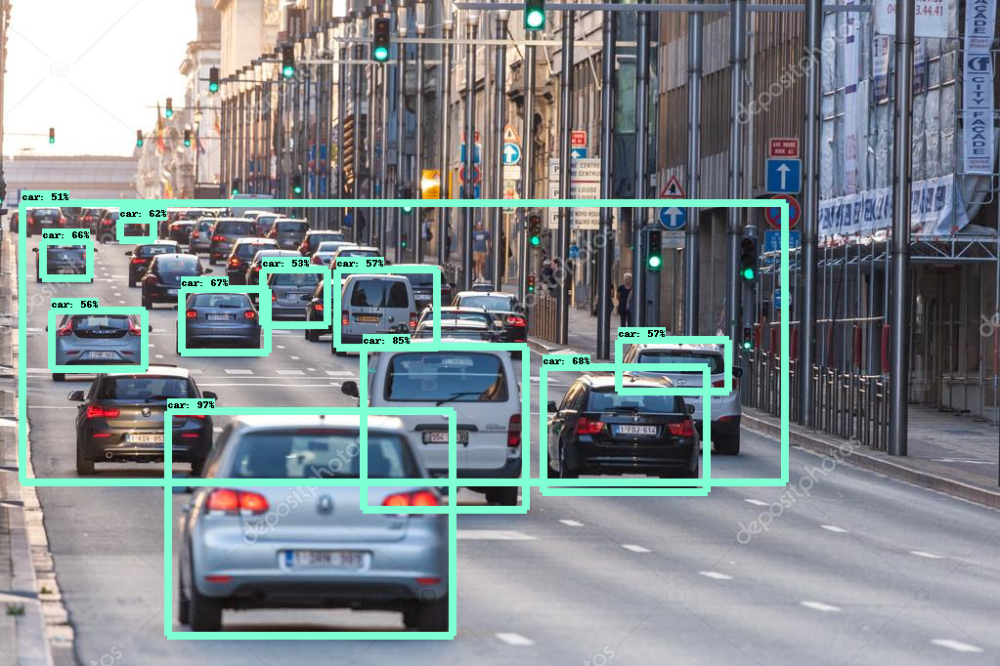

{'detection_scores': array([0.9662005 , 0.8506363 , 0.6835551 , 0.6664593 , 0.664876  ,
       0.6202516 , 0.5699109 , 0.565073  , 0.5645693 , 0.5337237 ,
       0.51136035, 0.46903732, 0.4663698 , 0.4647555 , 0.44461876,
       0.42041904, 0.41407323, 0.39036453, 0.38496277, 0.3570221 ,
       0.35435098, 0.34858128, 0.33770847, 0.33338088, 0.32404456,
       0.31204867, 0.30262762, 0.29204744, 0.23392686, 0.21033528,
       0.2081655 , 0.20624357, 0.20043364, 0.19632807, 0.18661165,
       0.1841647 , 0.17148948, 0.16887751, 0.16457617, 0.16383716,
       0.16245592, 0.15933502, 0.15900007, 0.15567344, 0.14716941,
       0.14529735, 0.14229   , 0.1342594 , 0.13274297, 0.13150796,
       0.13019311, 0.13014397, 0.12486961, 0.12293121, 0.12132174,
       0.11949447, 0.11884806, 0.1187225 , 0.11777407, 0.11619556,
       0.11594787, 0.11491483, 0.11471492, 0.11462083, 0.11431858,
       0.11401579, 0.11335984, 0.11000094, 0.10901487, 0.10846296,
       0.1080353 , 0.10728312, 0.10706323

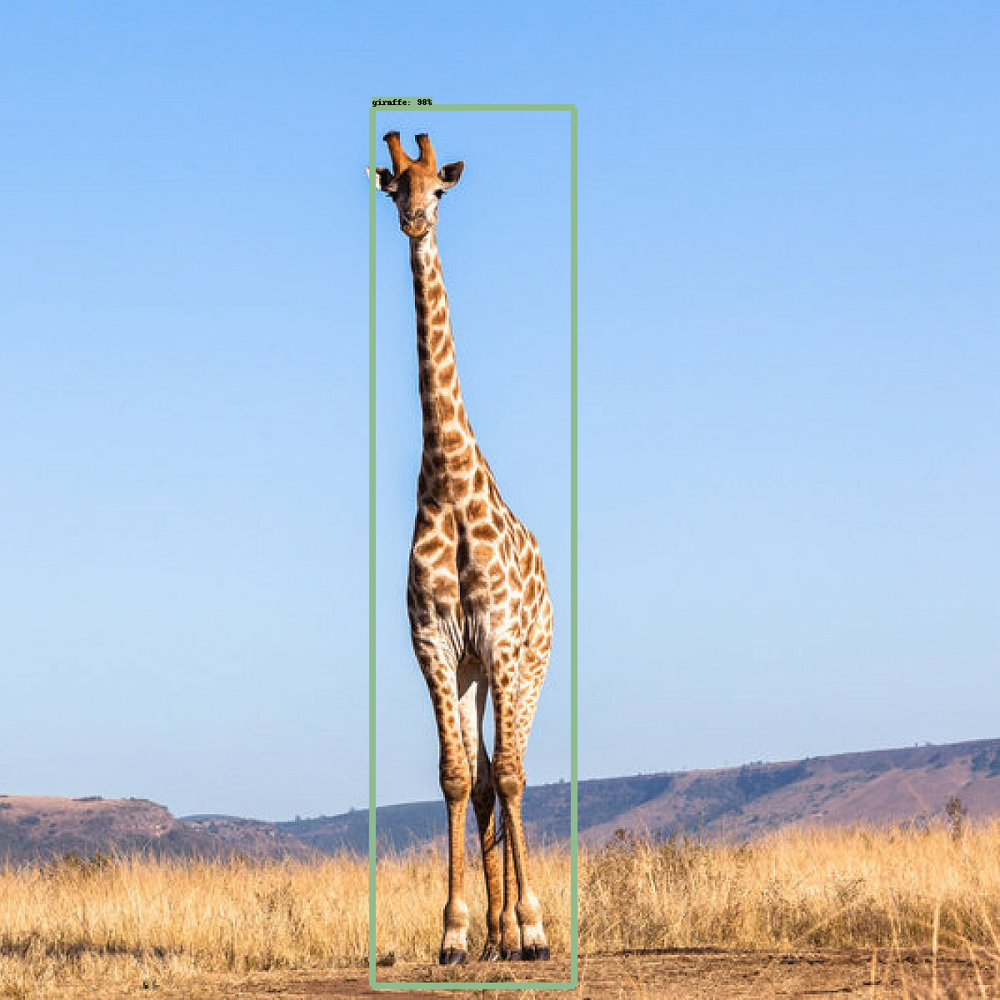

{'detection_scores': array([0.9760972 , 0.04740125, 0.04187924, 0.03719664, 0.03528324,
       0.03469139, 0.03359631, 0.03352237, 0.03197238, 0.03195512,
       0.02858442, 0.02811682, 0.0278292 , 0.02747884, 0.02700686,
       0.02610627, 0.0258593 , 0.02574673, 0.02542505, 0.02424923,
       0.02337423, 0.02327999, 0.02308044, 0.02301422, 0.0228546 ,
       0.02211735, 0.02204478, 0.02186108, 0.02176461, 0.02104944,
       0.02100345, 0.02092645, 0.02088338, 0.02070758, 0.02067307,
       0.02017248, 0.0194515 , 0.01931605, 0.01873752, 0.01854125,
       0.01841977, 0.01827347, 0.018172  , 0.01816911, 0.01813638,
       0.01806664, 0.01796812, 0.01789638, 0.01785997, 0.01778552,
       0.01768395, 0.01766434, 0.01718861, 0.0170815 , 0.01695362,
       0.01686847, 0.01682705, 0.01664361, 0.0165351 , 0.01626796,
       0.01623383, 0.01608437, 0.01571453, 0.0156979 , 0.01564205,
       0.01561499, 0.01551348, 0.01547876, 0.01535219, 0.0153445 ,
       0.01515675, 0.01513302, 0.0149923 

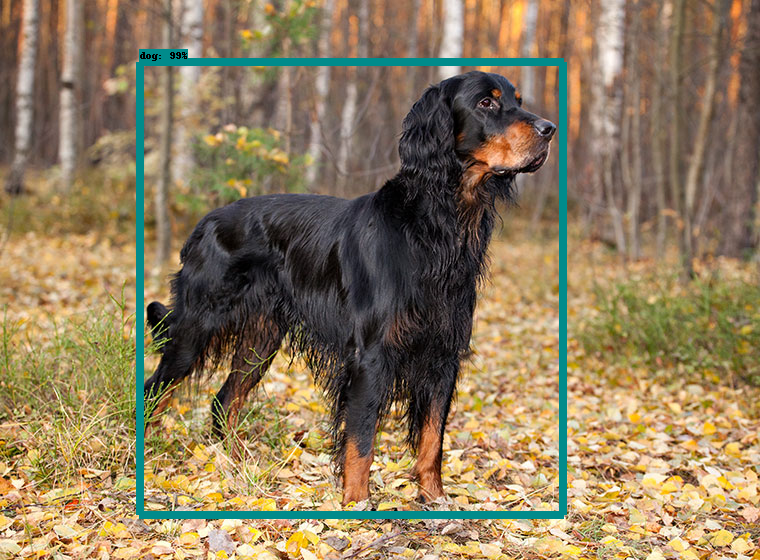

{'detection_scores': array([0.9858505 , 0.05427077, 0.04447922, 0.04085824, 0.03997159,
       0.03865466, 0.03238612, 0.03211108, 0.03139746, 0.03097466,
       0.03028974, 0.02937764, 0.02651998, 0.02626023, 0.02606058,
       0.02582607, 0.02525198, 0.02287227, 0.02138519, 0.02106869,
       0.02037197, 0.02012873, 0.01993448, 0.01985988, 0.01965252,
       0.01961243, 0.01916787, 0.01905292, 0.01810649, 0.01791999,
       0.01771325, 0.01684842, 0.01669338, 0.01667255, 0.0162361 ,
       0.01603752, 0.01597941, 0.01568347, 0.01562077, 0.01554242,
       0.0153394 , 0.01525015, 0.01513362, 0.01513121, 0.014965  ,
       0.0148603 , 0.01474047, 0.01462784, 0.01450121, 0.01447821,
       0.01445529, 0.01443109, 0.01439002, 0.01434737, 0.01430833,
       0.01425144, 0.01412246, 0.0141187 , 0.0139111 , 0.01383796,
       0.01370963, 0.01352179, 0.01351124, 0.01350269, 0.01349825,
       0.01341864, 0.0133006 , 0.0132702 , 0.01325101, 0.01309314,
       0.01299208, 0.01298916, 0.01297107

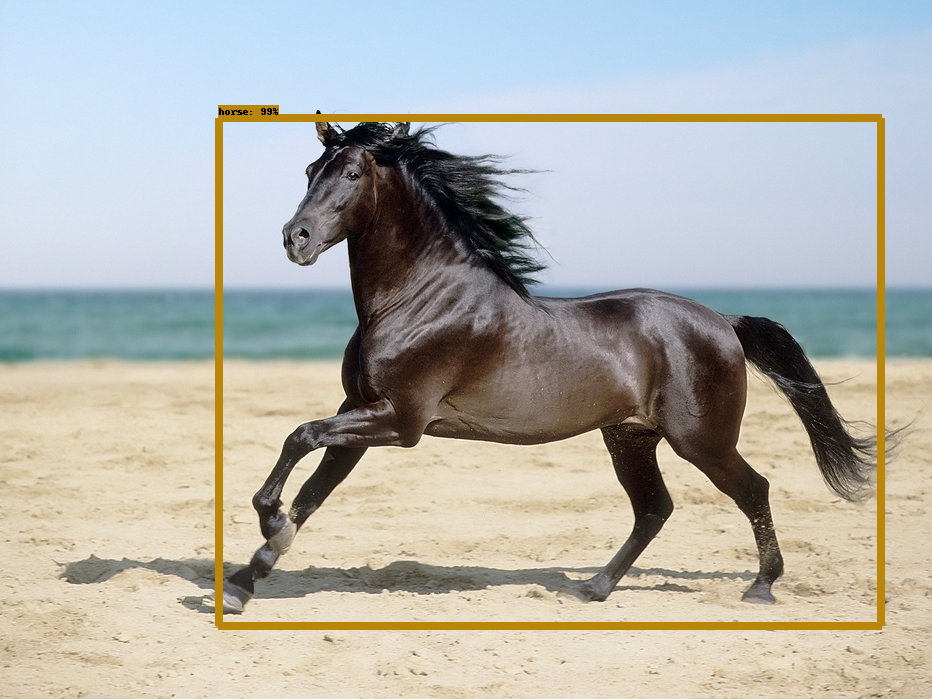

{'detection_scores': array([0.9901991 , 0.04172301, 0.04048327, 0.03607428, 0.03415364,
       0.033871  , 0.03145492, 0.02954286, 0.02813533, 0.02773261,
       0.02618769, 0.02611834, 0.02603918, 0.02574351, 0.02574274,
       0.02572581, 0.02559724, 0.02508289, 0.02426559, 0.02422145,
       0.02418023, 0.02381021, 0.02364048, 0.02344236, 0.02342054,
       0.02334759, 0.02320579, 0.02274799, 0.02259788, 0.02200952,
       0.02169031, 0.02154356, 0.02153265, 0.02128732, 0.02127135,
       0.02069592, 0.0202041 , 0.02008066, 0.01997608, 0.01880017,
       0.01868737, 0.01868242, 0.01848659, 0.01832461, 0.01826036,
       0.0180791 , 0.018067  , 0.01800129, 0.01788545, 0.01774627,
       0.01769024, 0.01731172, 0.01717845, 0.01711166, 0.0170415 ,
       0.01701549, 0.01694992, 0.01674908, 0.01668206, 0.01660803,
       0.01653239, 0.01635608, 0.0162833 , 0.01622915, 0.01609823,
       0.01607603, 0.0160332 , 0.0159626 , 0.01586804, 0.01579523,
       0.01577392, 0.01561457, 0.01555917

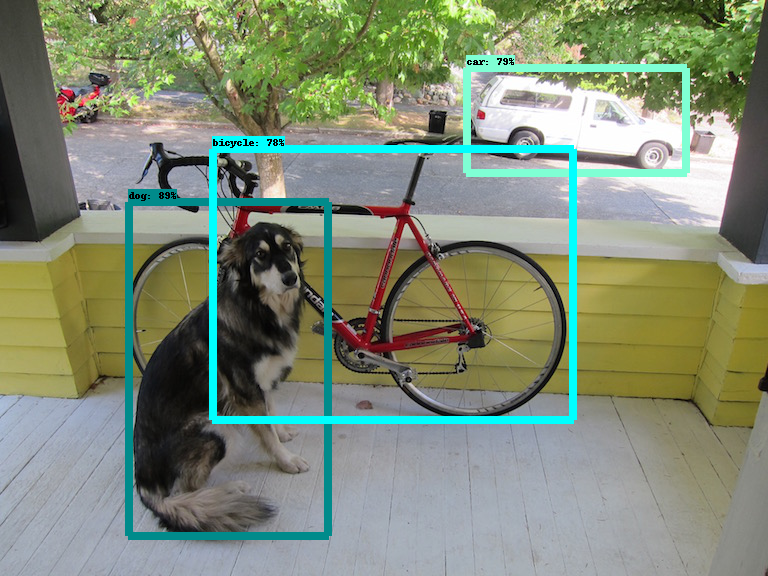

{'detection_scores': array([0.8946944 , 0.792843  , 0.78264403, 0.43392754, 0.26978582,
       0.15706506, 0.13025007, 0.12708536, 0.12443697, 0.12060842,
       0.1202969 , 0.11406785, 0.08978039, 0.0820387 , 0.08042556,
       0.07920694, 0.07790267, 0.07717505, 0.07550058, 0.07351202,
       0.06904194, 0.06847671, 0.06603569, 0.06472209, 0.06184554,
       0.06105384, 0.05968976, 0.05913025, 0.05744481, 0.05605528,
       0.05547702, 0.05506036, 0.05412644, 0.05378446, 0.05342489,
       0.05294037, 0.0522154 , 0.05182043, 0.05123654, 0.05098835,
       0.05074733, 0.05062848, 0.05020216, 0.04990533, 0.04985237,
       0.04948413, 0.04912916, 0.04911309, 0.04867446, 0.0482848 ,
       0.04816312, 0.04787451, 0.0477863 , 0.04760355, 0.04675582,
       0.04668805, 0.04535872, 0.04421917, 0.04367244, 0.04347715,
       0.04288992, 0.04268759, 0.04252452, 0.04219788, 0.04204527,
       0.04191533, 0.04167131, 0.04131049, 0.0412358 , 0.0408439 ,
       0.04066265, 0.04055002, 0.0403918 

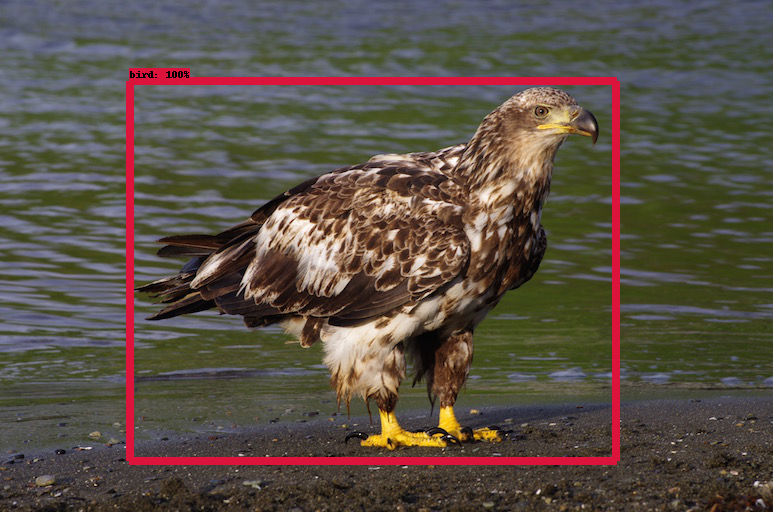

{'detection_scores': array([0.9960983 , 0.04655316, 0.04263332, 0.04029852, 0.03966638,
       0.03950885, 0.03628379, 0.03591606, 0.03087243, 0.0282945 ,
       0.02829006, 0.02808148, 0.02783242, 0.02678832, 0.02610981,
       0.02583757, 0.02574453, 0.0257237 , 0.02507862, 0.02469054,
       0.0246444 , 0.02425799, 0.02401128, 0.02394691, 0.02370596,
       0.02355659, 0.02342343, 0.02279636, 0.02275893, 0.02256209,
       0.02215183, 0.02212638, 0.02207252, 0.02178171, 0.02177802,
       0.02097765, 0.02094504, 0.02076557, 0.02056175, 0.02051076,
       0.0201304 , 0.02003321, 0.01985314, 0.01985222, 0.01985052,
       0.01961765, 0.01946941, 0.01937515, 0.01926965, 0.01920897,
       0.01913676, 0.01883951, 0.01881301, 0.01879191, 0.01869753,
       0.01843506, 0.01834244, 0.01829624, 0.0182752 , 0.01827449,
       0.01823103, 0.01822552, 0.01814383, 0.01811689, 0.01800162,
       0.01792452, 0.01780832, 0.01777855, 0.01776516, 0.01770326,
       0.01760289, 0.01752788, 0.01722991

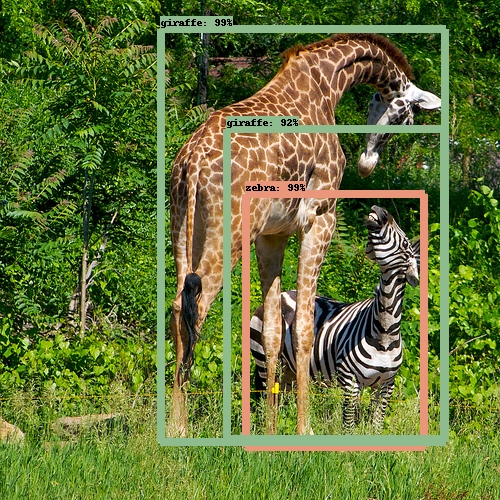

{'detection_scores': array([0.9918587 , 0.98504263, 0.9185201 , 0.10907871, 0.05235159,
       0.04882374, 0.03600273, 0.03597802, 0.03550032, 0.03528854,
       0.03416499, 0.03142539, 0.03134874, 0.03008524, 0.02942494,
       0.02919427, 0.02882802, 0.02806804, 0.02696112, 0.02635634,
       0.02635568, 0.02619365, 0.0258342 , 0.02572298, 0.02558109,
       0.02527314, 0.02516234, 0.02478987, 0.02425051, 0.02395493,
       0.02314058, 0.02244014, 0.02239618, 0.02095494, 0.02077198,
       0.0207549 , 0.02051932, 0.01995569, 0.01991254, 0.01973867,
       0.01940703, 0.01940355, 0.01914895, 0.01878434, 0.01869357,
       0.01867741, 0.01843029, 0.01838702, 0.01831764, 0.01805973,
       0.01725733, 0.01704234, 0.01661435, 0.01644525, 0.01639518,
       0.01635996, 0.01633957, 0.01627648, 0.01614013, 0.01611006,
       0.0161055 , 0.01595902, 0.01588553, 0.01587498, 0.01554975,
       0.01553938, 0.01547819, 0.01543343, 0.01523861, 0.01519459,
       0.01506931, 0.01498178, 0.01475808

[[[139 148 177]
  [139 148 177]
  [139 148 177]
  ...
  [138 154 187]
  [138 154 188]
  [138 154 188]]

 [[139 148 177]
  [139 148 177]
  [139 148 177]
  ...
  [139 155 188]
  [139 155 189]
  [139 155 189]]

 [[139 148 177]
  [139 148 177]
  [139 148 177]
  ...
  [141 156 189]
  [140 156 189]
  [140 156 190]]

 ...

 [[142 123  90]
  [135 117  95]
  [142 124 112]
  ...
  [123 105  81]
  [118 102  79]
  [148 132 109]]

 [[150 129  98]
  [157 137 113]
  [164 145 130]
  ...
  [117 100  74]
  [134 116  92]
  [125 109  86]]

 [[ 96  71  49]
  [125 103  79]
  [138 121  95]
  ...
  [135 115  90]
  [118 100  76]
  [ 91  73  51]]] [[4.15879548e-01 5.64114690e-01 6.86686575e-01 7.71397591e-01]
 [3.64743412e-01 5.11652231e-03 8.07801902e-01 4.09831136e-01]
 [3.97498250e-01 3.05885136e-01 7.01161146e-01 5.80724716e-01]
 [3.51509690e-01 1.05416328e-01 7.78020740e-01 5.04731417e-01]
 [4.27676231e-01 3.62608373e-01 6.99630260e-01 5.45868397e-01]
 [3.59111577e-01 0.00000000e+00 5.08676469e-01 2.276045

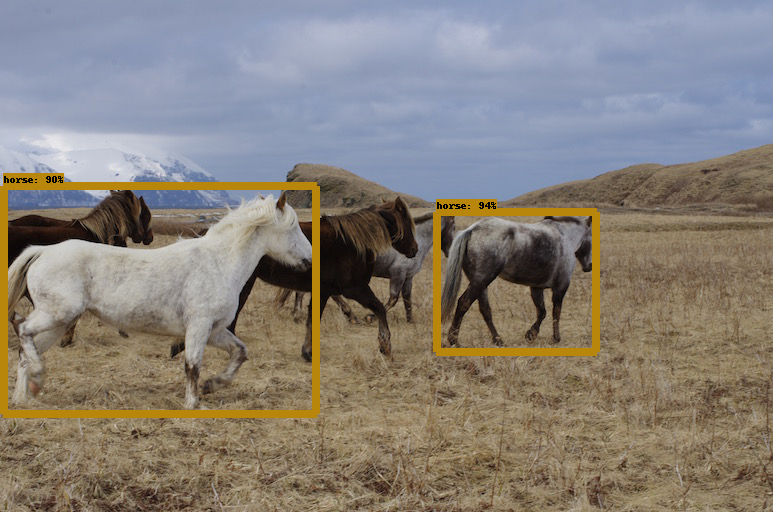

{'detection_scores': array([0.94389296, 0.89787334, 0.44769433, 0.26347232, 0.17241555,
       0.14215893, 0.09252515, 0.09241349, 0.08295456, 0.07983887,
       0.07077137, 0.06382254, 0.06129432, 0.05833346, 0.05680224,
       0.05531836, 0.05333328, 0.05105221, 0.0503321 , 0.04832244,
       0.04718432, 0.04370567, 0.0436804 , 0.04204208, 0.04201034,
       0.04038471, 0.03974703, 0.03930107, 0.03892016, 0.03870168,
       0.03844765, 0.03822619, 0.03750974, 0.03690866, 0.03690773,
       0.03685775, 0.03622413, 0.0356102 , 0.03497052, 0.03443664,
       0.03420383, 0.03383324, 0.0335221 , 0.03342655, 0.03314745,
       0.03243709, 0.03218794, 0.03190824, 0.03164956, 0.03072762,
       0.03013992, 0.02996096, 0.02924719, 0.02884933, 0.02835292,
       0.02829647, 0.02826017, 0.0282023 , 0.02717623, 0.02663916,
       0.02662808, 0.02628678, 0.02612928, 0.02595598, 0.0258438 ,
       0.02564931, 0.02563277, 0.02547482, 0.02540478, 0.02537891,
       0.02529222, 0.02527636, 0.02520055

[[[232 228 229]
  [236 232 233]
  [235 231 232]
  ...
  [241 239 240]
  [241 239 240]
  [240 238 239]]

 [[236 232 233]
  [237 233 234]
  [237 233 234]
  ...
  [240 238 239]
  [242 240 241]
  [241 239 240]]

 [[236 232 233]
  [236 232 233]
  [235 231 232]
  ...
  [244 240 241]
  [242 238 239]
  [245 241 242]]

 ...

 [[223 171 124]
  [227 173 129]
  [226 168 128]
  ...
  [179 145 108]
  [182 147 109]
  [176 136 100]]

 [[221 168 124]
  [224 170 126]
  [230 173 128]
  ...
  [184 148 112]
  [176 139 110]
  [187 150 124]]

 [[227 176 133]
  [227 173 129]
  [230 173 128]
  ...
  [181 141 115]
  [190 153 124]
  [188 154 127]]] [[5.53876817e-01 3.94223809e-01 5.93124688e-01 4.09137666e-01]
 [3.82946461e-01 3.45824122e-01 4.02200967e-01 3.59029889e-01]
 [5.74166656e-01 5.76669872e-02 6.23351812e-01 7.47537762e-02]
 [7.99144208e-02 4.37409133e-01 1.65902466e-01 5.00602841e-01]
 [2.65642822e-01 2.01122910e-01 3.07535172e-01 2.23093837e-01]
 [6.83380783e-01 7.84299523e-02 8.40588152e-01 1.178257

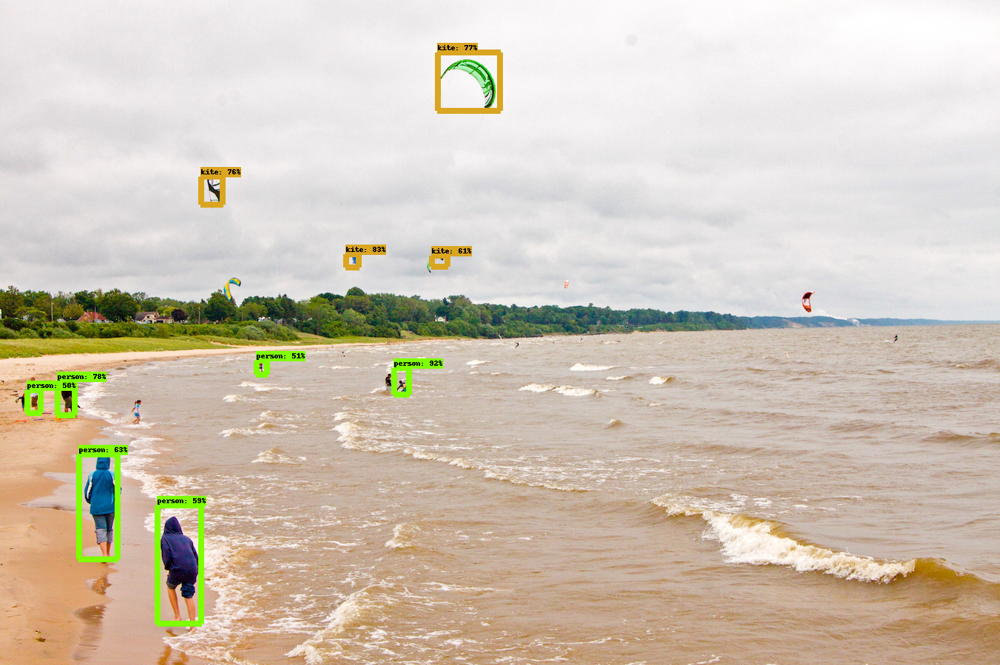

{'detection_scores': array([0.9168782 , 0.82944536, 0.7785053 , 0.7699845 , 0.7555398 ,
       0.6342342 , 0.6074061 , 0.58910173, 0.51237726, 0.5014632 ,
       0.45562565, 0.4176197 , 0.27231804, 0.2316361 , 0.15385723,
       0.14558885, 0.14348951, 0.1401189 , 0.13811764, 0.1380718 ,
       0.13758343, 0.13332912, 0.13263977, 0.13230133, 0.13200232,
       0.1125949 , 0.10983956, 0.10983786, 0.10552409, 0.10533255,
       0.10393625, 0.10349023, 0.10199106, 0.09910172, 0.09688905,
       0.09407309, 0.0928739 , 0.09211755, 0.08808193, 0.0868454 ,
       0.08297262, 0.07948196, 0.07784909, 0.07461584, 0.07099614,
       0.0689083 , 0.06855568, 0.06851846, 0.06694466, 0.06641561,
       0.0656614 , 0.06417328, 0.06338853, 0.06278509, 0.0625048 ,
       0.06187859, 0.06157416, 0.06122804, 0.05966544, 0.05857033,
       0.05827793, 0.05767855, 0.05757335, 0.05558535, 0.05548409,
       0.05537081, 0.05516249, 0.05510336, 0.05456123, 0.05284497,
       0.05271533, 0.05261531, 0.05241254

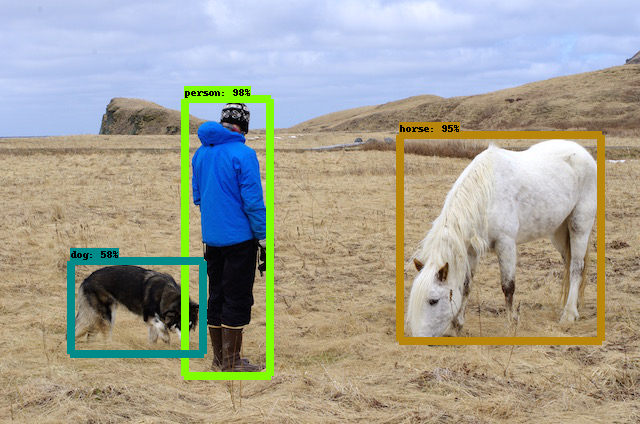

{'detection_scores': array([0.9824704 , 0.9547373 , 0.57766783, 0.4062128 , 0.11973688,
       0.0609507 , 0.06005812, 0.05583411, 0.05156225, 0.04881829,
       0.04724327, 0.04396954, 0.04384416, 0.04278669, 0.04127118,
       0.04039839, 0.0394375 , 0.03863779, 0.03664038, 0.03627768,
       0.03568187, 0.03515911, 0.03419048, 0.03407371, 0.03366444,
       0.03363183, 0.03345555, 0.03340334, 0.03332382, 0.03226084,
       0.03218007, 0.03179494, 0.03123119, 0.03107125, 0.03006619,
       0.02989474, 0.02881983, 0.02867755, 0.0285497 , 0.02790523,
       0.02780256, 0.02751067, 0.02735293, 0.02727029, 0.02704307,
       0.02694178, 0.02669126, 0.02650103, 0.02619833, 0.0260863 ,
       0.02588439, 0.02539325, 0.02509141, 0.02499273, 0.02489975,
       0.02458665, 0.02456611, 0.02425572, 0.02412838, 0.0238511 ,
       0.02341864, 0.02339822, 0.02298999, 0.02251995, 0.02222872,
       0.021963  , 0.02178237, 0.02164155, 0.02139369, 0.02106678,
       0.02074707, 0.02048895, 0.02043521

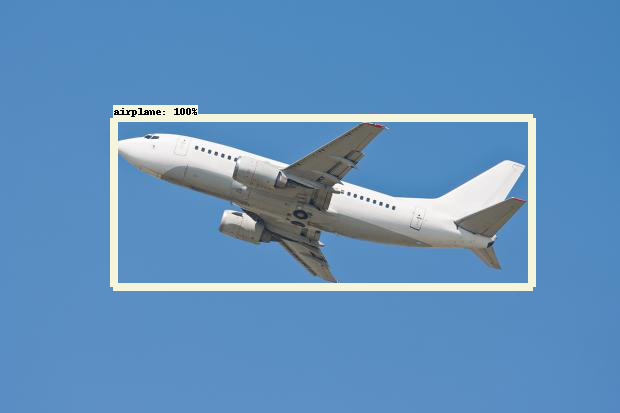

{'detection_scores': array([0.9978682 , 0.05392653, 0.0538387 , 0.05008847, 0.04350111,
       0.04307052, 0.04296023, 0.04104686, 0.03924364, 0.03575456,
       0.03282943, 0.0309549 , 0.02922997, 0.02866739, 0.02622256,
       0.02608672, 0.02598399, 0.02587855, 0.02423251, 0.02400827,
       0.02391711, 0.02364737, 0.02320793, 0.0227744 , 0.0227448 ,
       0.02260888, 0.02254292, 0.02238363, 0.02206996, 0.02168328,
       0.02112207, 0.02091375, 0.02087244, 0.0203976 , 0.01997241,
       0.01954159, 0.01953259, 0.01949298, 0.01928437, 0.01912868,
       0.01904872, 0.01890689, 0.01887751, 0.01878148, 0.01828822,
       0.01780915, 0.01694193, 0.01673734, 0.01630282, 0.01616555,
       0.01605573, 0.0160203 , 0.01600224, 0.01600173, 0.0159044 ,
       0.01585466, 0.015697  , 0.01565167, 0.01561362, 0.01535049,
       0.01516545, 0.01516455, 0.01505005, 0.01494735, 0.01483497,
       0.01473859, 0.01470071, 0.01458544, 0.0142754 , 0.01415634,
       0.01412904, 0.01409182, 0.01405728

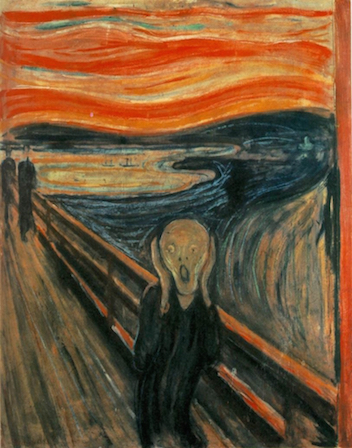

{'detection_scores': array([0.44671497, 0.35736093, 0.15170181, 0.13210109, 0.11086524,
       0.09613073, 0.09583643, 0.09557599, 0.09290332, 0.08430716,
       0.08058208, 0.07826495, 0.07612327, 0.07529631, 0.074435  ,
       0.07340133, 0.07215509, 0.07201472, 0.07105201, 0.07012323,
       0.06966871, 0.06803828, 0.06592771, 0.06552523, 0.06548217,
       0.06482553, 0.06454292, 0.06437814, 0.06434125, 0.06416562,
       0.064008  , 0.06372479, 0.06357405, 0.06288058, 0.06238341,
       0.06232601, 0.06205848, 0.06165481, 0.06105521, 0.06082007,
       0.06036624, 0.05951989, 0.05935746, 0.05909982, 0.05766839,
       0.0571197 , 0.05710158, 0.05708432, 0.05707136, 0.05609357,
       0.0560165 , 0.05582598, 0.0555923 , 0.05549011, 0.05544007,
       0.05526763, 0.05491781, 0.05471954, 0.05466804, 0.05410475,
       0.05403978, 0.05378217, 0.05352098, 0.05336767, 0.05314806,
       0.05267844, 0.05267555, 0.05208537, 0.05190217, 0.0515455 ,
       0.05144641, 0.05101278, 0.05096483

In [59]:
for image_path in TEST_IMAGE_PATHS:
    print(show_inference(detection_model, image_path))


## Instance Segmentation

In [37]:
model_name = "mask_rcnn_inception_resnet_v2_atrous_coco_2018_01_28"
masking_model = load_model(model_name)

727392256/727390102 [==============================] - 216s 0us/step
INFO:tensorflow:Saver not created because there are no variables in the graph to restore


The instance segmentation model includes a `detection_masks` output:

In [38]:
masking_model.signatures['serving_default'].output_shapes

{'num_detections': TensorShape([None]),
 'detection_masks': TensorShape([None, None, None, None]),
 'detection_classes': TensorShape([None, 100]),
 'detection_boxes': TensorShape([None, 100, 4]),
 'detection_scores': TensorShape([None, 100])}

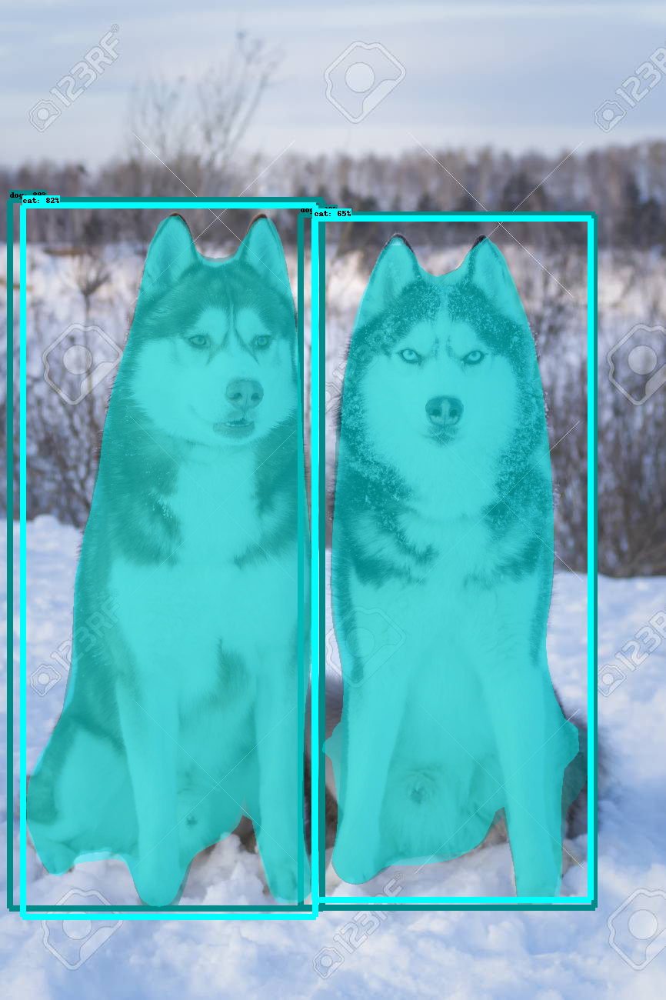

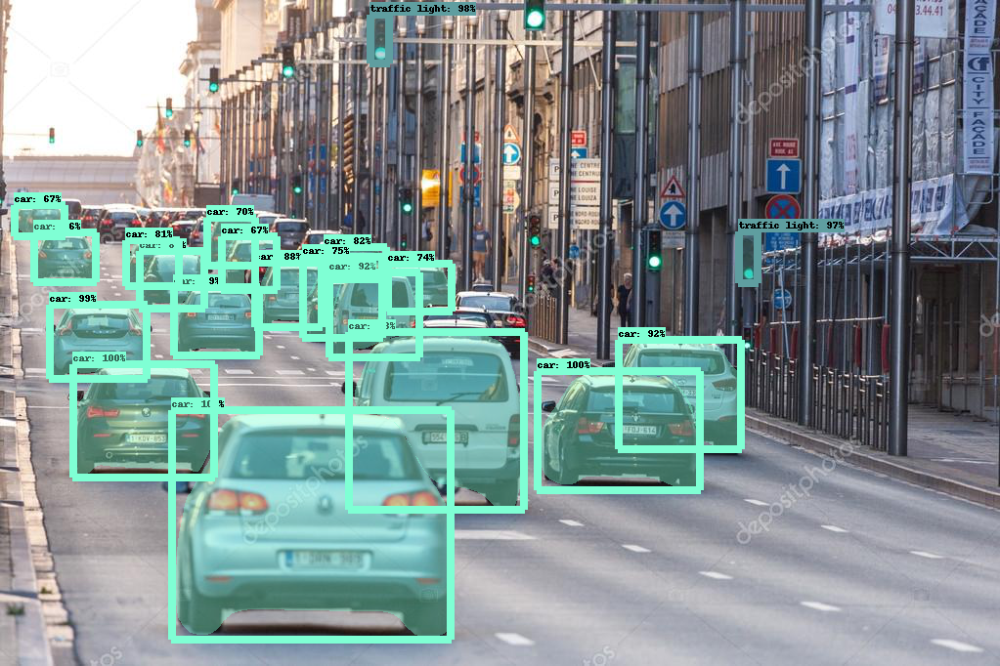

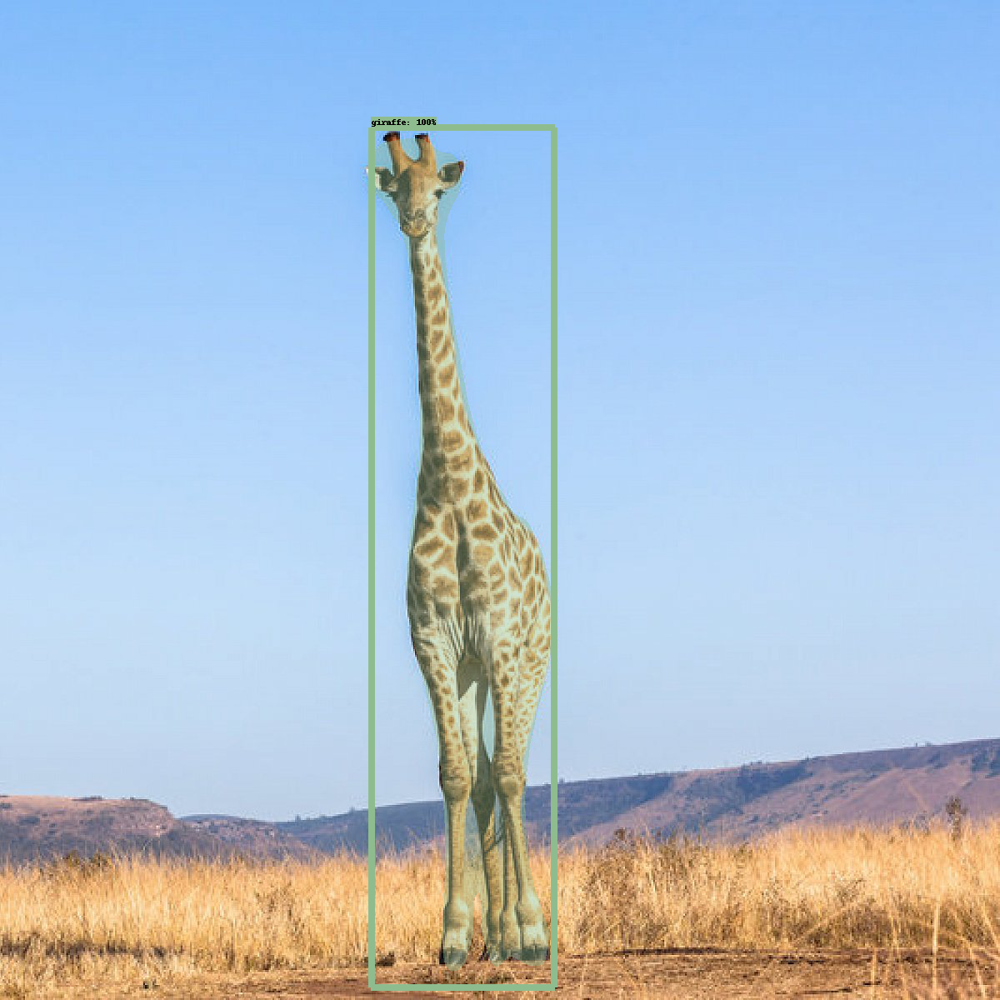

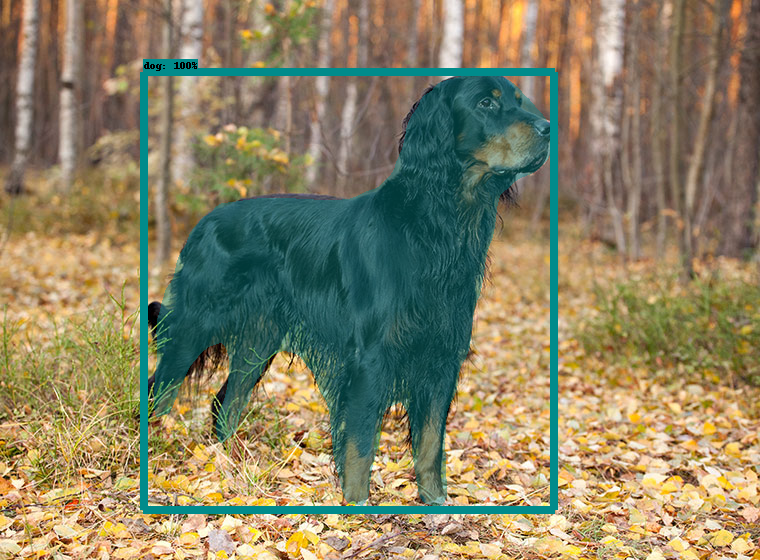

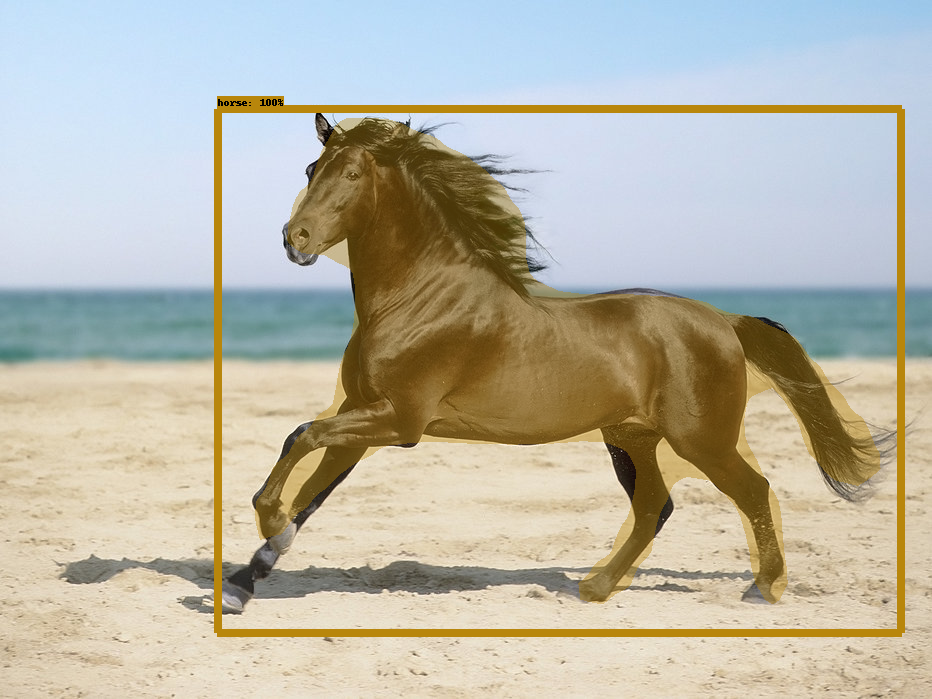

...

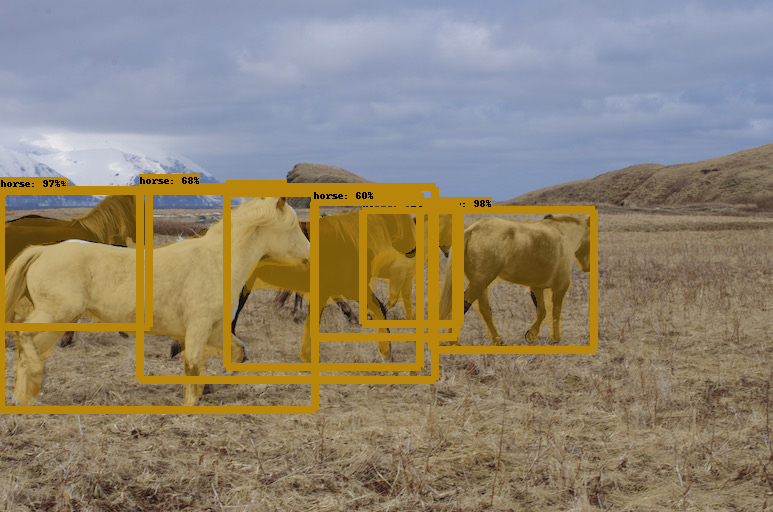

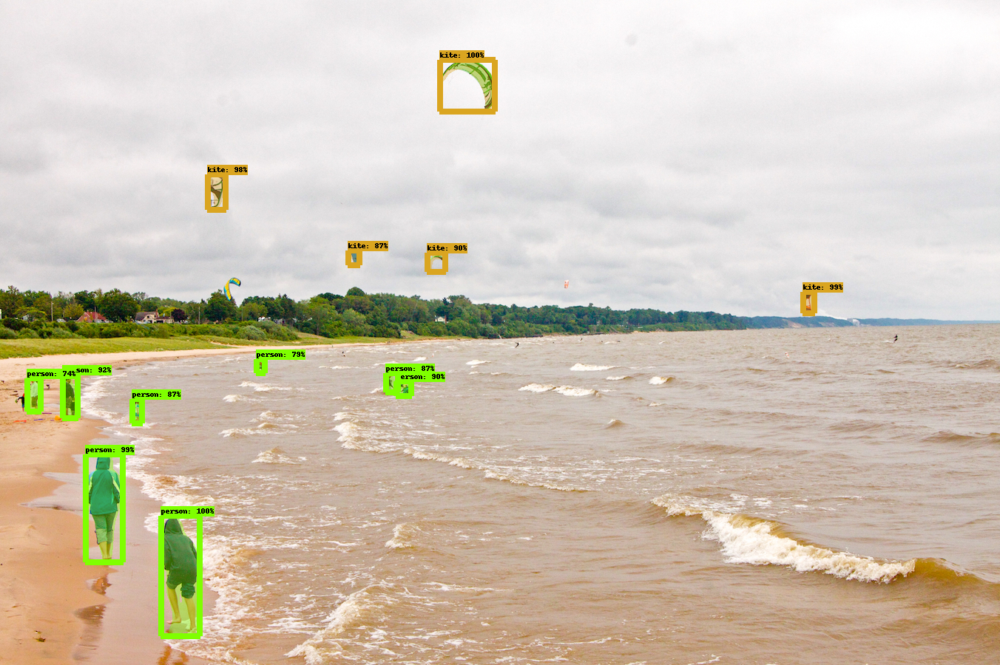

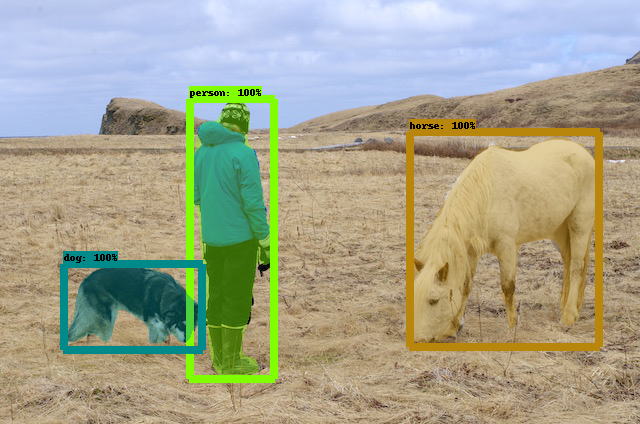

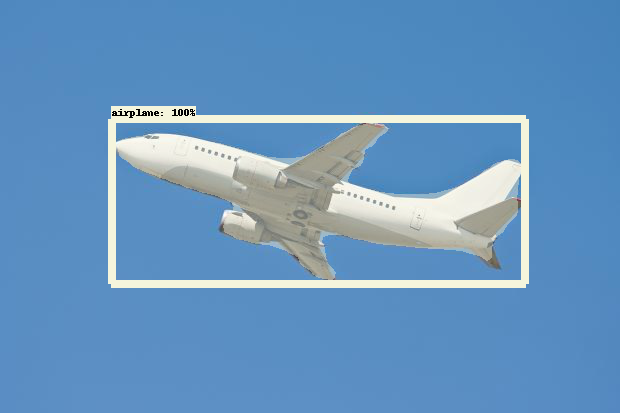

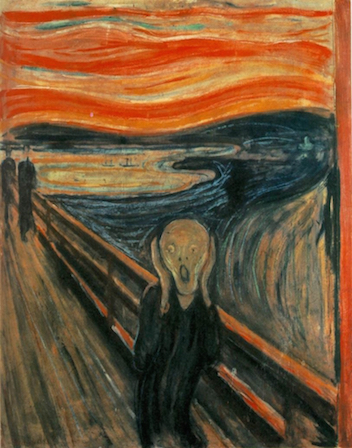

In [39]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(masking_model, image_path)